In [1]:
!pip install missingno

In [2]:
import pandas as pd
import missingno as msno
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

# **Glossário do conjunto de dados**

---

Este conjunto de dados fornece uma visão geral abrangente dos perfis de potenciais solicitantes de empréstimos, adaptados especificamente para o grupo demográfico indiano. Abrange uma série de características, desde dados demográficos básicos até detalhes financeiros, que podem ser fundamentais na avaliação da solvabilidade de um indivíduo.

*   Idade

*   Gênero

*   Renda

*   Pontuação de crédito

*   Comprimento do histórico de crédito

*   Montante do empréstimo

*   Posse do empréstimo

*   Cliente existente

*   Estado

*   Cidade

*   Índice LTV

*   Perfil de emprego

*   Pontuação do perfil

*   Ocupação

# **Lendo** **a** **base**


In [3]:
df = pd.read_csv('/content/credit_data.csv')
df

,Age,Gender,Income,Credit Score,Credit History Length,Number of Existing Loans,Loan Amount,Loan Tenure,Existing Customer,State,City,LTV Ratio,Employment Profile,Profile Score,Occupation
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,NaN
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer


# **Preparando a base**

In [4]:
df = df.rename(columns={'Age': 'Idade', 'Gender': 'Genero', 'Income': 'Renda', 'Credit Score': 'Pontuacao credito', 'Credit History Length': 'Comprimento historico credito',
                   'Number of Existing Loans': 'numero emprestimos existentes', 'Loan Amount': 'Montante emprestimo', 'Loan Tenure': 'Posse emprestimo', 'Existing Customer': 'Cliente existente',
                   'State': 'Estado', 'City': 'Cidade', 'LTV Ratio': 'indice LTV', 'Employment Profile': 'Perfil emprego', 'Profile Score': 'Pontuacao perfil', 'Occupation': 'Ocupacao'})

In [5]:
df.columns = df.columns.str.lower()
df

,idade,genero,renda,pontuacao credito,comprimento historico credito,numero emprestimos existentes,montante emprestimo,posse emprestimo,cliente existente,estado,cidade,indice ltv,perfil emprego,pontuacao perfil,ocupacao
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,NaN
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer


In [6]:
df.columns =  df.columns.str.replace('\W','')
df

<ipython-input-6-4e8007dea1b0>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df.columns =  df.columns.str.replace('\W','')


,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,NaN
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer


# **Analisando Duplicados**

In [7]:
df.duplicated().sum()

100814

In [8]:
df.loc[df.duplicated() == True]

,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
1184,50,Male,145000,850,524,10,58056,125,Yes,Gujarat,Surat,51.527648,Salaried,92,Software Engineer
1362,52,Male,42000,300,453,0,150000,19,No,Rajasthan,Nellikuppam,53.150230,Freelancer,49,Writer
1412,47,Male,103000,850,418,10,150000,235,Yes,Rajasthan,Udaipur,48.432548,Self-Employed,97,Shopkeeper
1451,41,Female,71000,464,520,2,150000,92,No,Gujarat,Surat,62.575652,Salaried,78,Doctor
1748,30,Female,51000,322,146,0,150000,79,No,Telangana,Hyderabad,69.528528,Freelancer,37,Writer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279848,40,Female,48000,555,365,4,129247,82,No,Uttar Pradesh,Manjari,95.000000,Freelancer,60,Independent Consultant
279849,50,Male,72000,300,465,0,150000,59,No,Rajasthan,Jaipur,58.839934,Salaried,67,Banker
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,NaN


Por mais que tenha dados duplicados na base, não são respectivamente do mesmo indivíduo, até porque não yem o nome da pessoa, o que se repete são algumas informações de idade e etc... no qual não significa que é um duplicata porque as informações no decorrer daquela linha, muda em uma coluna e outra.

# **Tratando valores missing**

<Axes: >

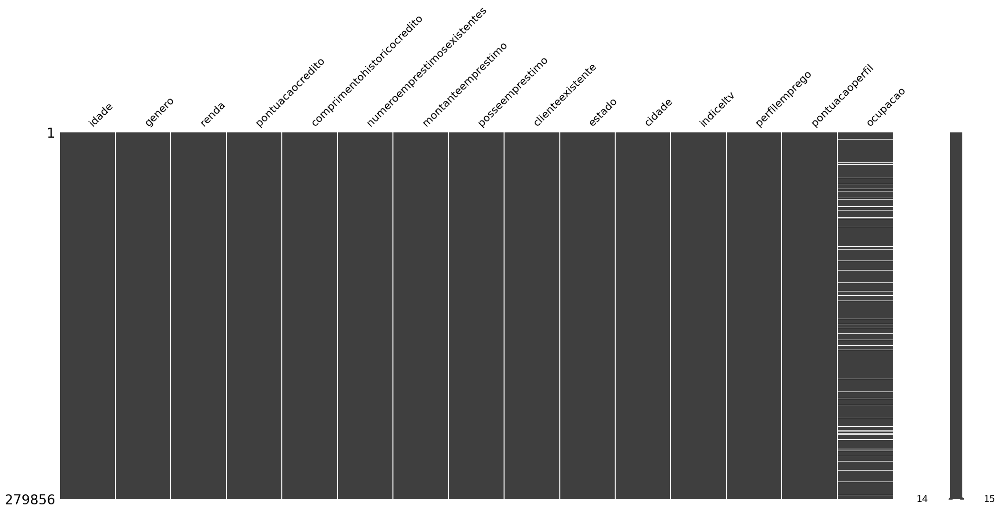

In [9]:
msno.matrix(df)

In [10]:
df.isna().sum()

idade                              0
genero                             0
renda                              0
pontuacaocredito                   0
comprimentohistoricocredito        0
numeroemprestimosexistentes        0
montanteemprestimo                 0
posseemprestimo                    0
clienteexistente                   0
estado                             0
cidade                             0
indiceltv                          0
perfilemprego                      0
pontuacaoperfil                    0
ocupacao                       18272
dtype: int64

In [11]:
18272/279856*100

6.5290720942198845

Observei que a coluna de ocupacao tem aproximadamente 6.5% de valores missing, porém não irei remover pois não vejo necessidade, na qual acabaria perdendo dados de outras colunas que ao meu ver são muito importantes para análise final dos dados. Irei inputar dado no lugar.


In [12]:
df["ocupacao"].fillna("Não Informado", inplace=True)
df


,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,Não Informado
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer


# **Tabela com os dados missing tratados**

<Axes: >

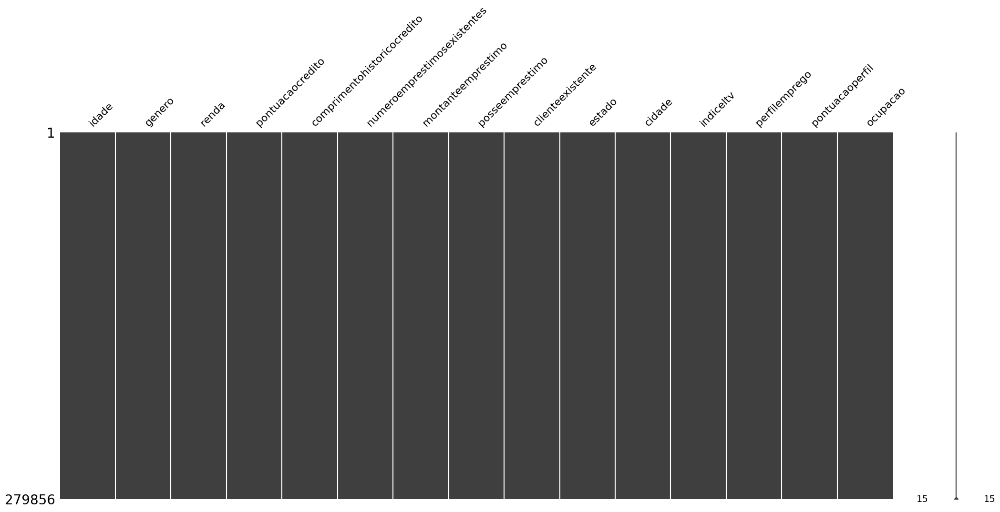

In [13]:
msno.matrix(df)

# **Tratando valores outliers**

In [14]:
px.box(df.renda)

In [15]:
df.renda.describe()

count    279856.000000
mean      76499.163856
std       42875.575193
min        9000.000000
25%       42000.000000
50%       68000.000000
75%      104000.000000
max      209000.000000
Name: renda, dtype: float64

In [16]:
#Peguei os valores dos quartis 1 e 3

q1 = np.percentile(df.renda, 25)
q3 = np.percentile(df.renda, 75)


In [17]:
# Clculamos o valor do limite inferior
li = q1 - (1.5*(q3-q1))
li

-51000.0

In [18]:
# Clculamos o valor do limite superior
ls = q3 + (1.5*(q3-q1))
ls


197000.0

In [19]:
df.loc[df.renda > 197000.0]

,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
679,70,Male,202000,521,320,4,75333,40,No,Uttar Pradesh,Kanpur,92.897060,Self-Employed,44,Farmer
1028,69,Male,202000,424,176,2,150000,86,No,Tamil Nadu,Chennai,75.993393,Freelancer,45,Graphic Designer
1045,70,Female,201000,779,489,8,150000,93,Yes,Delhi,New Delhi,77.965231,Salaried,100,Teacher
1218,70,Male,203000,850,119,10,83960,345,Yes,Rajasthan,Jaipur,68.945743,Salaried,100,Doctor
1436,70,Male,209000,850,128,10,131023,146,Yes,Delhi,Channarayapatna,72.893150,Salaried,100,Software Engineer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278463,70,Female,199000,689,175,7,94013,306,Yes,Delhi,Manjari,67.840435,Salaried,98,Teacher
279396,70,Female,198000,559,84,4,124384,94,No,Karnataka,Bengaluru,95.000000,Self-Employed,77,Business Owner
279420,69,Male,198000,533,570,4,150000,56,No,Tamil Nadu,Coimbatore,87.977811,Freelancer,64,Writer
279539,68,Female,198000,396,27,1,70675,105,No,Tamil Nadu,Chennai,93.454150,Salaried,29,Teacher


In [20]:
df.loc[df.renda > 197000.0, 'renda'] = 197000.0

In [21]:
px.box(df.renda)

A coluna Renda é uma variável continua, e por ser tratar de renda os outliers em muitos casos são levados em consideração, mas pra esse estudo que é de perfis de potenciais solicitantes de empréstimos, eu entendo, visto que algumas pessoas podem ter uma renda muito alta do que das outras, a análise do dado acaba perdendo um pouco sua relevância, dessa forma decidi travar os outliers maiores que o valor maxímo no valor maxímo.

In [22]:
px.box(df.pontuacaoperfil)

In [23]:
df.pontuacaoperfil.describe()

count    279856.000000
mean         77.350155
std          24.509196
min           0.000000
25%          61.000000
50%          89.000000
75%          98.000000
max         100.000000
Name: pontuacaoperfil, dtype: float64

In [24]:
#Peguei os valores dos quartis 1 e 3

q1 = np.percentile(df.pontuacaoperfil, 25)
q3 = np.percentile(df.pontuacaoperfil, 75)


In [25]:
# Clculamos o valor do limite inferior
li = q1 - (1.5*(q3-q1))
li

5.5

In [26]:
# Clculamos o valor do limite superior
ls = q3 + (1.5*(q3-q1))
ls


153.5

In [27]:
df.groupby(by=['pontuacaoperfil', 'renda']).sum()

<ipython-input-27-ae4c3e2c1e07>:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



idade  pontuacaocredito  comprimentohistoricocredito  \
pontuacaoperfil renda                                                          
0               10000     108              2016                         2097   
                11000     120              2022                          606   
                13000     129              1800                         1767   
                15000     189              2553                         2320   
                16000     237              2510                         1240   
...                       ...               ...                          ...   
100             193000   3766             42128                        17657   
                194000   4935             56072                        23302   
                195000   2358             26662                        14925   
                196000   2165             22698                        11536   
                197000  20205            223235                        86322   

                        numeroemprestimosexistentes  montanteemprestimo  \
pontuacaoperfil renda                                                     
0               10000                             3               94155   
                11000                             3              252132   
                13000                             0              148293   
                15000                             0              552350   
                16000                             0              374385   
...                                             ...                 ...   
100             193000                          440             7399131   
                194000                          596             8945000   
                195000                          281             4522701   
                196000                          222             4277283   
                197000                         2346            37082815   

                        posseemprestimo     indiceltv  
pontuacaoperfil renda                                  
0               10000               600    549.503344  
                11000               186    566.626617  
                13000               579    562.328499  
                15000               599    755.417684  
                16000               648    744.641683  
...                                 ...           ...  
100             193000            11825   3633.813448  
                194000            18109   4410.949866  
                195000             7748   1922.322304  
                196000             5611   2043.251626  
                197000            58824  17766.170410  

[13851 rows x 7 columns]

In [28]:
df.loc[df.pontuacaoperfil < 5.5]


,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
116,69,Female,51000,311,196,0,59282,43,No,Maharashtra,Mumbai,95.000000,Self-Employed,0,Farmer
127,28,Female,28000,300,74,0,76802,64,No,West Bengal,Kolkata,95.000000,Student,0,Student
445,23,Male,58000,300,336,0,123590,19,No,Delhi,New Delhi,95.000000,Self-Employed,2,Shopkeeper
548,59,Male,29000,373,205,1,73193,104,No,Karnataka,Mysuru,95.000000,Unemployed,0,Não Informado
739,39,Male,42000,300,264,0,124406,71,No,Kerala,Thiruvananthapuram,90.946626,Student,0,Student
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279051,32,Male,36000,307,127,0,144490,66,No,Telangana,Hyderabad,95.000000,Freelancer,4,Photographer
279073,31,Female,36000,300,471,0,88856,83,No,Delhi,New Delhi,95.000000,Freelancer,0,Independent Consultant
279074,31,Female,69000,300,508,0,89140,102,No,West Bengal,Kolkata,95.000000,Unemployed,1,Não Informado
279667,27,Male,35000,391,452,1,44261,52,No,Karnataka,Mysuru,95.000000,Student,3,Student


In [29]:
df.loc[df.pontuacaoperfil < 6, 'pontuacaoperfil'] = 6

In [30]:
px.box(df.pontuacaoperfil)

Tentei achar uma correlação com as colunas pontuaçãoperfil e renda por exemplo, e não encontrei nenhuma correlaçaõ que me explique ou me mostre que devo deixar os valores outliers da coluna pontuaçãoperfil, olhando a base toda, numa visão horizontal da tabela, não encontrei nenhuma correlação evidente, dessa forma travei os dados outliers maiores que o valor minímo no valor minímo.

# **Medidas de posição e dispersão das variaveis**

In [31]:
df.describe()

,idade,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,indiceltv,pontuacaoperfil
count,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000
mean,44.005217,76483.370019,582.953773,307.965146,4.701693,105795.342773,133.340654,71.643101,77.376683
std,15.311051,42829.873767,163.076754,175.083268,2.980351,40458.370929,96.064132,16.865785,24.429000
min,18.000000,9000.000000,300.000000,6.000000,0.000000,5294.000000,12.000000,40.000000,6.000000
25%,31.000000,42000.000000,446.000000,156.000000,2.000000,72173.000000,62.000000,58.105848,61.000000
50%,44.000000,68000.000000,584.000000,307.000000,5.000000,111263.000000,100.000000,72.133017,89.000000
75%,57.000000,104000.000000,722.000000,460.000000,7.000000,150000.000000,201.000000,86.239725,98.000000
max,70.000000,197000.000000,850.000000,611.000000,10.000000,150000.000000,359.000000,95.000000,100.000000


- idade: a média de idade na minha base é de 44 anos; quando a idade desvia, desvia em torno de 15 anos em relação a média; e 50% dos meus dados vão até a idade de 44 anos.

- renda: a média de renda na minha base é de 76483.37; quando a renda desvia, desvia em torno de 42829 em relação a média; e 50% dos meus dados vão até a renda de 68000.

- pontuacaocredito: a média de pontuacaocredito na minha base é de 582; quando a pontuacaocredito desvia, desvia em torno de 163 em relação a média; e 50% dos meus dados vão até a pontuacaocredito de 584.

- comprimentohistoricocredito: a média de comprimentohistoricocredito na minha base é de 307; quando a comprimentohistoricocredito desvia, desvia em torno de 175 em relação a média; e 50% dos meus dados vão até a comprimentohistoricocredito de 307.

- numeroemprestimosexistentes: a média de numeroemprestimosexistentes na minha base é de 4.7; quando a numeroemprestimosexistentes desvia, desvia em torno de 3 em relação a média; e 50% dos meus dados vão até a numeroemprestimosexistentes de 5.

- montanteemprestimo: a média de montanteemprestimo na minha base é de 105795; quando a montanteemprestimo desvia, desvia em torno de 40458 em relação a média; e 50% dos meus dados vão até a montanteemprestimo de 111263.

- posseemprestimo: a média de posseemprestimo na minha base é de 133; quando a posseemprestimo desvia, desvia em torno de 96 em relação a média; e 50% dos meus dados vão até a posseemprestimo de 100.

- indiceltv: a média de indiceltv na minha base é de 71; quando a indiceltv desvia, desvia em torno de 16 em relação a média; e 50% dos meus dados vão até a indiceltv de 72.

- pontuaçãoperfil: a média de pontuaçãoperfil na minha base é de 77; quando a pontuaçãoperfil desvia, desvia em torno de 24 em relação a média; e 50% dos meus dados vão até a pontuaçãoperfil de 89.

In [32]:
for variavel in ['idade', 'renda', 'pontuacaocredito', 'comprimentohistoricocredito', 'numeroemprestimosexistentes', 'montanteemprestimo', 'posseemprestimo', 'indiceltv', 'pontuacaoperfil']:
 fig = px.histogram(df[''+variavel+''])
 fig.show()

# **Gráficos**

In [33]:
df

,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,Não Informado
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer


In [34]:
df2 = df.copy()
df2['genero2']='maculimo'
df2.loc[df2.genero=='Female', 'genero2']='feminino'

dfaux = df2.groupby('genero2')['genero'].count().reset_index(drop=False)

In [35]:
figcateg = px.pie(dfaux, values='genero', names='genero2')
figcateg.show()

Neste gráfico de variável categórica nominal, analisei a variável de sexo, onde pude observar que na base, 54% das pessoas são do sexo masculino, e 47% do sexo feminino.

In [36]:
perfilemprego = df['perfilemprego'].value_counts()

<Axes: >

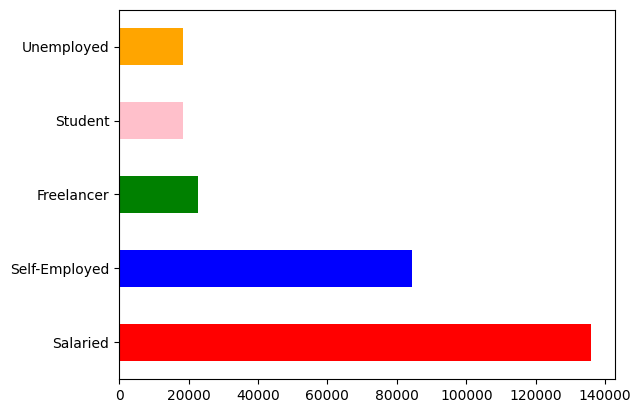

In [37]:
perfilemprego.plot(kind='barh', color = ['red', 'blue', 'green', 'pink', 'orange'])

No gráfico acima, usei novamente uma variável categórica nominal, mas dessa vez quis analisar a variável de perfil de emprego, na qual observei que a categoria que mais aparece na base é a de Assalariado, com aproximadamente 140.000 pessoas, logo atrás vem os que trabalha por conta própria, com um valor aproximado de 80.500 pessoas... um valor até que razoável para essa categoria.

Infelizmente, na base, não encontrei uma variável para que eu possa fazer uma análise categórica ordinal.

<ipython-input-38-5e792a3c9fe8>:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<Axes: xlabel='renda', ylabel='Density'>

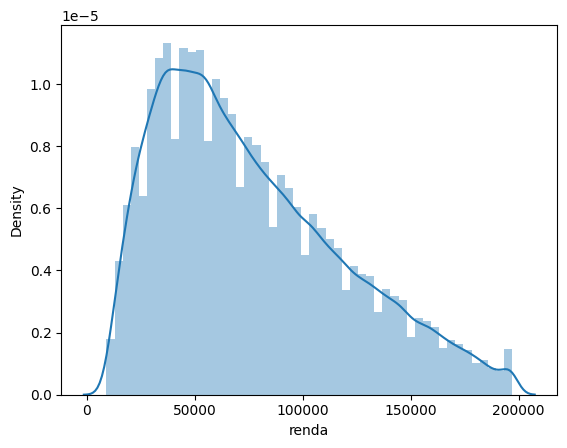

In [38]:
sns.distplot(df['renda'])

No gráfico acima, analisei a variável de renda sendo esta discreta, na qual fica evidente que a maioria das pessoas tem uma renda de 40 à 70 mil.

<ipython-input-39-22670bbcefea>:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<Axes: xlabel='indiceltv', ylabel='Density'>

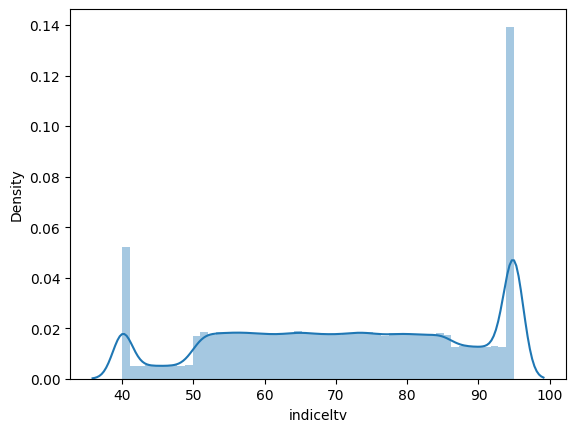

In [39]:
sns.distplot(df['indiceltv'])

In [40]:
px.histogram(df['indiceltv'])

Nesses dois gráficos a cima, pude observar que a variável indice ltv sendo essa contínua, representa a relação entre o valor do empréstimo e o valor de avaliação do ativo (normalmente uma casa). LTVs mais altos podem indicar maior risco.

Dessa forma, analisando os dois gráficos, observei que temos duas proporções que se sobressaem, a primeira porção de 39.7% à 40,2%, um valor de 14.725 pessoas. Já a proporção maior, é de 94.7% à 95.2%, com um valor de 39.905 mil pessoas.

# **Feature Engeneering**

In [41]:
df

,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,Não Informado
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer


In [42]:
df.shape

(279856, 15)

In [43]:
df.columns

Index(['idade', 'genero', 'renda', 'pontuacaocredito',
       'comprimentohistoricocredito', 'numeroemprestimosexistentes',
       'montanteemprestimo', 'posseemprestimo', 'clienteexistente', 'estado',
       'cidade', 'indiceltv', 'perfilemprego', 'pontuacaoperfil', 'ocupacao'],
      dtype='object')

# **Análise da variável Ocupacao**

In [44]:
df.ocupacao

0                    Doctor
1         Software Engineer
2                    Banker
3                Contractor
4                   Teacher
                ...        
279851    Software Engineer
279852        Civil Servant
279853        Não Informado
279854    Software Engineer
279855    Software Engineer
Name: ocupacao, Length: 279856, dtype: object

In [45]:
df.ocupacao.value_counts()

Banker                    27760
Teacher                   27356
Civil Servant             27221
Software Engineer         27146
Doctor                    26582
Shopkeeper                21405
Contractor                21090
Farmer                    20966
Business Owner            20908
Student                   18521
Não Informado             18272
Graphic Designer           5723
Photographer               5706
Independent Consultant     5628
Writer                     5572
Name: ocupacao, dtype: int64

In [46]:
df_perfilpont = df.groupby(['ocupacao'])['pontuacaoperfil'].agg(['mean', 'count']).sort_values(by=['mean'], ascending=False).reset_index().rename(columns={'mean':'mediapontuacaoperfil', 'count':'totocupacao'})

In [47]:
df_perfilpont

,ocupacao,mediapontuacaoperfil,totocupacao
0,Civil Servant,82.525807,27221
1,Banker,82.459762,27760
2,Software Engineer,82.260444,27146
3,Teacher,82.236073,27356
4,Doctor,82.103717,26582
5,Contractor,75.993030,21090
6,Business Owner,75.395303,20908
7,Farmer,75.375656,20966
8,Shopkeeper,75.268021,21405
9,Writer,74.454594,5572


In [48]:
df = pd.merge(df, df_perfilpont, on='ocupacao', how='left')

In [49]:
df.shape

(279856, 17)

Resolvi criar uma variável chamada mediapontuacaoperfil, que me trás para minha análise mais profunda, quais são as ocupações que tem os maiores perfis gerais dos solicitantes com base nos dados reais de reembolso do empréstimo. Valores mais altos indicam melhores perfis.

Pude observar que os três melhores perfis são:

- Civil Servant - 82.5 pontos;

- Banker - 82,4 pontos;

- Software Engineer -  82,2 pontos.

# **Dummificação**

In [50]:
df

,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao,mediapontuacaoperfil,totocupacao
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor,82.103717,26582
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer,82.260444,27146
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker,82.459762,27760
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor,75.993030,21090
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher,82.236073,27356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer,82.260444,27146
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant,82.525807,27221
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,Não Informado,65.205396,18272
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer,82.260444,27146


In [51]:
df.pontuacaocredito.describe()

count    279856.000000
mean        582.953773
std         163.076754
min         300.000000
25%         446.000000
50%         584.000000
75%         722.000000
max         850.000000
Name: pontuacaocredito, dtype: float64

In [52]:
df['metapontuacaocredito'] = (df.pontuacaocredito<584)*1

In [53]:
df.metapontuacaocredito.mean()

0.49869218455205533

In [54]:
df.metapontuacaocredito

0         0
1         1
2         0
3         0
4         0
         ..
279851    1
279852    0
279853    1
279854    1
279855    1
Name: metapontuacaocredito, Length: 279856, dtype: int64

In [55]:
df.groupby(['metapontuacaocredito'])['pontuacaoperfil'].agg('mean')

metapontuacaocredito
0    93.783975
1    60.883335
Name: pontuacaoperfil, dtype: float64

In [56]:
df.describe()

,idade,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,indiceltv,pontuacaoperfil,mediapontuacaoperfil,totocupacao,metapontuacaocredito
count,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000,279856.000000
mean,44.005217,76483.370019,582.953773,307.965146,4.701693,105795.342773,133.340654,71.643101,77.376683,77.376683,22468.930879,0.498692
std,15.311051,42829.873767,163.076754,175.083268,2.980351,40458.370929,96.064132,16.865785,24.429000,5.695499,6054.064430,0.499999
min,18.000000,9000.000000,300.000000,6.000000,0.000000,5294.000000,12.000000,40.000000,6.000000,65.205396,5572.000000,0.000000
25%,31.000000,42000.000000,446.000000,156.000000,2.000000,72173.000000,62.000000,58.105848,61.000000,75.268021,20908.000000,0.000000
50%,44.000000,68000.000000,584.000000,307.000000,5.000000,111263.000000,100.000000,72.133017,89.000000,75.993030,21405.000000,0.000000
75%,57.000000,104000.000000,722.000000,460.000000,7.000000,150000.000000,201.000000,86.239725,98.000000,82.260444,27221.000000,1.000000
max,70.000000,197000.000000,850.000000,611.000000,10.000000,150000.000000,359.000000,95.000000,100.000000,82.525807,27760.000000,1.000000


In [57]:
df

,idade,genero,renda,pontuacaocredito,comprimentohistoricocredito,numeroemprestimosexistentes,montanteemprestimo,posseemprestimo,clienteexistente,estado,cidade,indiceltv,perfilemprego,pontuacaoperfil,ocupacao,mediapontuacaoperfil,totocupacao,metapontuacaocredito
0,31,Male,36000,604,487,5,109373,221,No,Karnataka,Mysuru,90.943430,Salaried,77,Doctor,82.103717,26582,0
1,25,Male,50000,447,386,2,150000,89,No,Karnataka,Bengaluru,91.135253,Salaried,43,Software Engineer,82.260444,27146,1
2,62,Other,178000,850,503,10,69099,110,Yes,Uttar Pradesh,Kanpur,40.000000,Salaried,90,Banker,82.459762,27760,0
3,69,Female,46000,668,349,6,150000,148,Yes,Karnataka,Bengaluru,87.393365,Self-Employed,86,Contractor,75.993030,21090,0
4,52,Male,132000,601,553,5,150000,157,No,Karnataka,Mysuru,66.158757,Salaried,90,Teacher,82.236073,27356,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279851,69,Male,61000,495,565,3,150000,14,No,Tamil Nadu,Chennai,90.300189,Salaried,71,Software Engineer,82.260444,27146,1
279852,45,Female,124000,850,476,10,80341,86,Yes,Karnataka,Bengaluru,78.960607,Salaried,91,Civil Servant,82.525807,27221,0
279853,33,Female,71000,582,560,5,39851,101,No,Karnataka,Mysuru,95.000000,Unemployed,57,Não Informado,65.205396,18272,1
279854,67,Male,191000,411,481,2,150000,111,No,Delhi,New Delhi,56.109002,Salaried,69,Software Engineer,82.260444,27146,1


In [58]:
meta = df.metapontuacaocredito.value_counts()

In [59]:
meta

0    140294
1    139562
Name: metapontuacaocredito, dtype: int64

<Axes: >

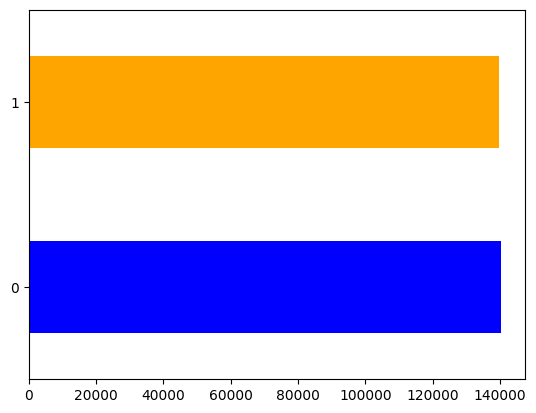

In [60]:
meta.plot(kind='barh', color = ['blue','orange'])

Criei uma outra variável chamada metapontuacaocredito, que tem valor de 0 ou 1.

A lógica dessa variável é, em cima da da variável pontuacaocredito, que significa uma pontuação que quantifica a qualidade de crédito do solicitante com base em seu histórico de crédito, peguei a média dessa coluna, e fiz uma condição que, a meta para ter uma pontução de crédito bom, é do valor da média para cima, se o valor for menor que a média, ele ainda não obteve a meta.

0 = obeteve a meta

1 = abaixo da meta

Com isso, pude observar que 140.294 pessoas nessa base alcançaram a meta, já 139.562 pessoas estão abaixo da meta.